In [1]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge, Lasso, RidgeCV, LassoCV, ElasticNet, ElasticNetCV, LogisticRegression
from sklearn.model_selection import train_test_split
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, roc_auc_score, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport
import pickle 

In [2]:
!pip install pandas_profiling

In [3]:
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/diabetes.csv")
df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [4]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Preporcessing

### 1. Removing Zeros

According to business logic, certain columns' value can't be zero

In [5]:
df.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

In [6]:
df["BMI"] = df["BMI"].replace(0, df["BMI"].mean())

In [7]:
df["BloodPressure"] = df["BloodPressure"].replace(0, df["BloodPressure"].mean())

In [8]:
df["Insulin"] = df["Insulin"].replace(0, df["Insulin"].mean())

In [9]:
df["Glucose"] = df["Glucose"].replace(0, df["Glucose"].mean())

In [10]:
df["SkinThickness"] = df["SkinThickness"].replace(0, df["SkinThickness"].mean())

In [11]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### 2. Removing Outliers

Outliers can be removed by treating quratile ranges.

<AxesSubplot:>

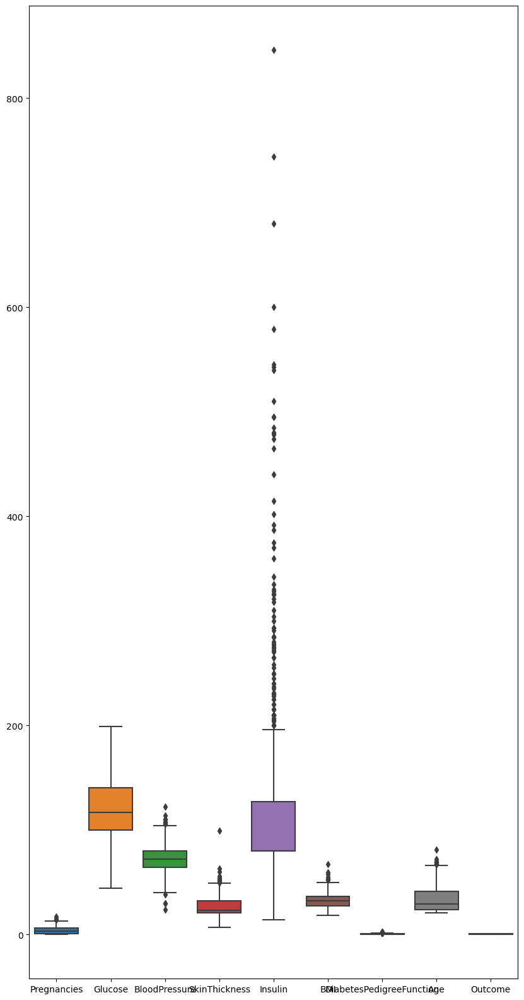

In [12]:
%matplotlib inline

fig, axis = plt.subplots(figsize=(10,20))
sns.boxplot(data=df, ax=axis)

In [13]:
q = df["Insulin"].quantile(.95)
df1 = df[df["Insulin"] < q]

q = df1["Pregnancies"].quantile(.99)
df1 = df1[df1["Pregnancies"] < q]

q = df1["BloodPressure"].quantile(.98)
df1 = df1[df1["BloodPressure"] < q]

q = df1["SkinThickness"].quantile(.98)
df1 = df1[df1["SkinThickness"] < q]

q = df1["DiabetesPedigreeFunction"].quantile(.97)
df1 = df1[df1["DiabetesPedigreeFunction"] < q]

q = df1["Age"].quantile(.97)
df1 = df1[df1["Age"] < q]

q = df1["BMI"].quantile(.99)
df1 = df1[df1["BMI"] < q]


In [14]:
df1.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

<AxesSubplot:>

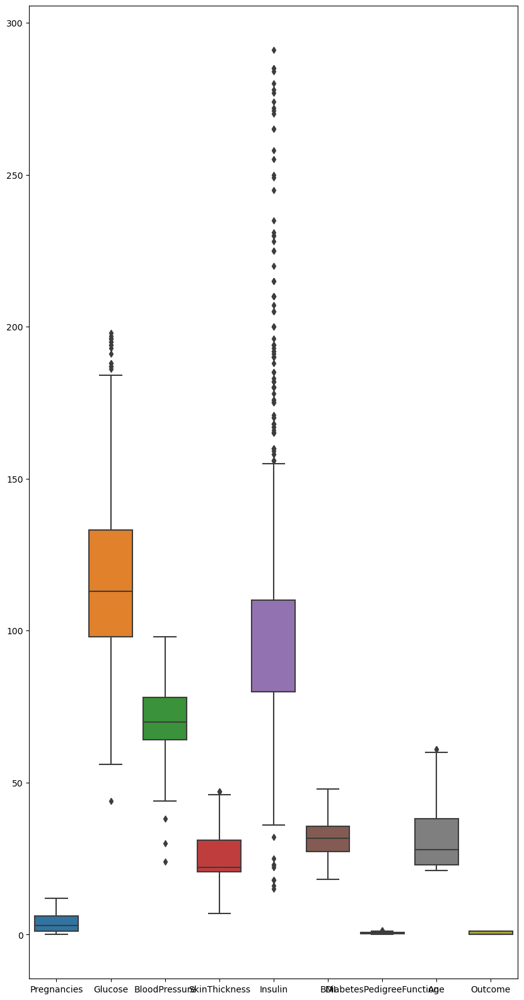

In [15]:
fig, axis = plt.subplots(figsize=(10,20))
sns.boxplot(data=df1, ax=axis)

In [16]:
ProfileReport(df1)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [17]:
df.shape

(768, 9)

In [18]:
df1.shape

(633, 9)

In [19]:
X = df1.drop(columns="Outcome")
X

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30
...,...,...,...,...,...,...,...,...
762,9,89.0,62.0,20.536458,79.799479,22.5,0.142,33
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47


In [20]:
y = df1["Outcome"]
y

0      1
1      0
2      1
3      0
5      0
      ..
762    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 633, dtype: int64

### Standard Scaling

Before getting into Standardization, let us first understand the concept of Scaling.

Scaling of Features is an essential step in modeling the algorithms with the datasets. The data that is usually used for the purpose of modeling is derived through various means such as Questionnaire, Surveys, Research, Scraping, etc.
So, the data obtained contains features of various dimensions and scales altogether. Different scales of the data features affect the modeling of a dataset adversely.

It leads to a biased outcome of predictions in terms of misclassification error and accuracy rates. Thus, it is necessary to Scale the data prior to modeling. This is when standardization comes into picture.

Standardization is a scaling technique wherein it makes the data scale-free by converting the statistical distribution of the data into the below format:

mean - 0 (zero)
standard deviation - 1
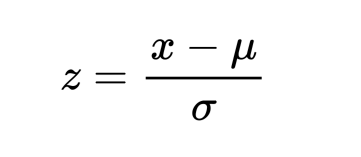

By this, the entire data set scales with a zero mean and unit variance, altogether. You need to do "from sklearn.preprocessing import StandardScaler"




In [21]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled

array([[ 0.77349303,  1.04656337,  0.0881668 , ...,  0.30468168,
         0.78607699,  1.86549473],
       [-0.8531551 , -1.1468851 , -0.47027806, ..., -0.81898192,
        -0.30493128, -0.05246604],
       [ 1.42415228,  2.26514586, -0.65642634, ..., -1.34870905,
         0.96395878,  0.04847926],
       ...,
       [ 0.4481634 ,  0.10651403,  0.0881668 , ..., -0.88319127,
        -0.7239417 , -0.15341135],
       [-0.8531551 ,  0.28059724, -1.02872291, ..., -0.25715012,
        -0.31283714,  1.56265882],
       [-0.8531551 , -0.86835196, -0.09798149, ..., -0.20899311,
        -0.44723671, -0.86002848]])

In [22]:
ProfileReport(pd.DataFrame(X_scaled))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<AxesSubplot:>

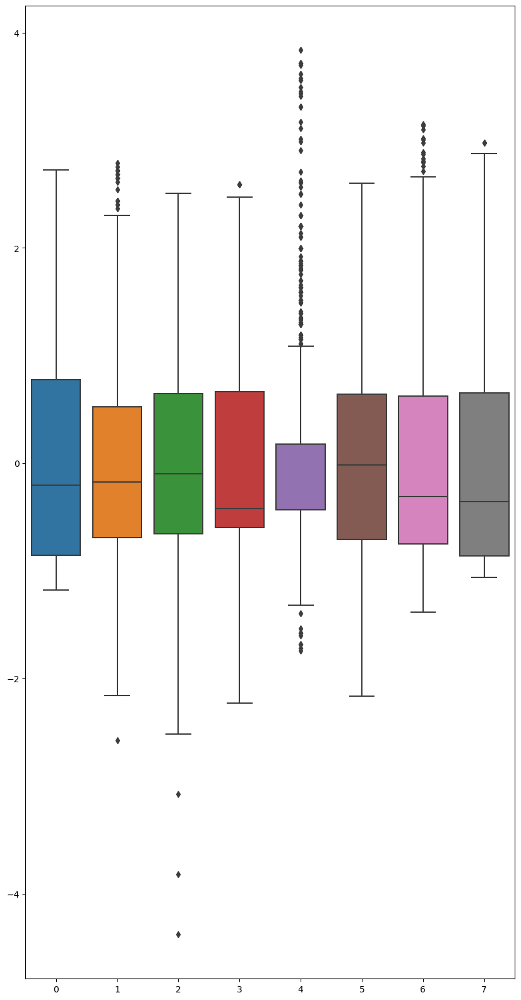

In [23]:
fig, axis = plt.subplots(figsize=(10,20))
sns.boxplot(data=X_scaled, ax=axis)

### Checking VIF (Variance Inflation Factor)

A variance inflation factor (VIF) is a measure of the amount of multicollinearity in regression analysis. Multicollinearity exists when there is a correlation between multiple independent variables in a multiple regression model. This can adversely affect the regression results. Thus, the variance inflation factor can estimate how much the variance of a regression coefficient is inflated due to multicollinearity.

In general terms,

-VIF equal to 1 = variables are not correlated
-VIF between 1 and 5 = variables are moderately correlated 
-VIF greater than 5 = variables are highly correlated

The higher the VIF, the higher the possibility that multicollinearity exists, and further research is required. When VIF is higher than 10, there is significant multicollinearity that needs to be corrected.

##### Formula:
 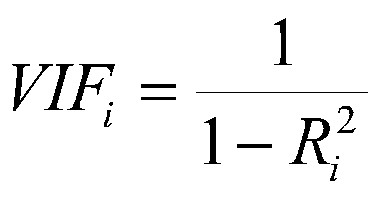


In our dataset, there is very low VIF, it means there is very low multi-colineartiy, so no need to remove any column.

In [24]:
def vif(x):
    return pd.DataFrame([[X.columns[i], variance_inflation_factor(X_scaled,i)] for i in range(X_scaled.shape[1])], columns=["Features", "VIF Score"])

In [25]:
vif(df)

,Features,VIF Score
0,Pregnancies,1.557890
1,Glucose,1.288074
2,BloodPressure,1.218379
3,SkinThickness,1.453476
4,Insulin,1.277187
5,BMI,1.515457
6,DiabetesPedigreeFunction,1.052079
7,Age,1.745697


In [26]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=.2, random_state=100)

In [27]:
X_train

array([[-0.20249585, -0.06756918,  0.27431508, ..., -0.86713894,
        -1.26944584, -0.75908317],
       [-0.8531551 , -1.32096831,  0.27431508, ..., -0.27320246,
         0.39078414, -0.96097378],
       [ 0.4481634 , -0.31128568,  0.36738922, ...,  0.68993777,
         0.46588978,  2.87494777],
       ...,
       [-1.17848473,  0.59394702,  2.13579793, ...,  1.42834528,
        -0.56977749, -0.55719256],
       [-0.52782548, -0.9031686 , -0.84257463, ..., -0.01636507,
        -1.17852848, -0.75908317],
       [ 1.09882266, -0.13720247, -0.65642634, ..., -0.69056323,
         1.20113449,  0.25036987]])

In [28]:
X_test

array([[-0.8531551 ,  0.35023052, -2.14561262, ...,  1.41229294,
         0.73073599, -0.75908317],
       [ 0.12283378, -0.06756918,  0.0881668 , ..., -1.5413371 ,
         0.13779672,  0.55320578],
       [ 1.09882266,  0.52431374,  1.57735308, ...,  0.11205363,
        -0.65674192,  0.55320578],
       ...,
       [-0.8531551 , -0.55500218,  0.27431508, ...,  1.25176957,
        -0.53420113,  1.0579323 ],
       [-0.52782548, -0.93798524, -0.84257463, ..., -0.70661556,
         0.38287828, -0.96097378],
       [-1.17848473, -0.55500218,  1.39120479, ..., -0.38556882,
         1.05487613, -0.45624726]])

In [29]:
y_train

527    0
432    0
30     0
767    0
19     1
      ..
705    0
66     1
428    0
96     0
630    1
Name: Outcome, Length: 506, dtype: int64

In [30]:
y_test

293    1
393    0
282    0
121    0
230    1
      ..
709    1
628    0
739    1
513    0
640    0
Name: Outcome, Length: 127, dtype: int64

In [31]:
classifier = LogisticRegression()
classifier.fit(X_train, y_train)

LogisticRegression()

In [32]:
y_prediction_default = classifier.predict(X_test)

In [33]:
accuracy_score(y_test, y_prediction_default)

0.7637795275590551

In [34]:
cm = confusion_matrix(y_test, y_prediction_default)
cm

array([[76,  7],
       [23, 21]], dtype=int64)

In [35]:
tn, fp, fn, tp = confusion_matrix(y_test, y_prediction_default).ravel()
print({"TP":tp, "FP":fp, "TN":tn, "FN":fn })

{'TP': 21, 'FP': 7, 'TN': 76, 'FN': 23}


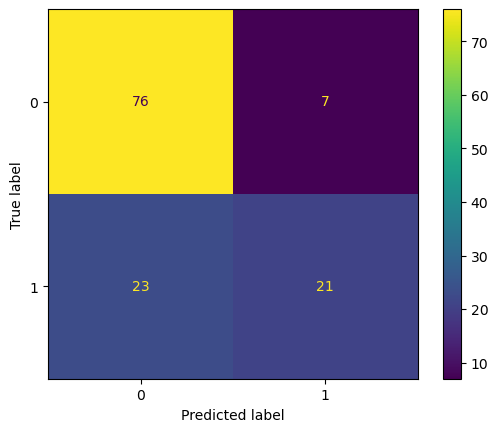

In [36]:
cmd = ConfusionMatrixDisplay(cm)
cmd.plot()

In [37]:
fpr, tpr, thresholds = roc_curve(y_test, y_prediction_default)
print({"FPR":fpr, "TPR":tpr, "Thresholds":thresholds})

{'FPR': array([0.        , 0.08433735, 1.        ]), 'TPR': array([0.        , 0.47727273, 1.        ]), 'Thresholds': array([2, 1, 0], dtype=int64)}


In [38]:
roc_auc_score(y_test, y_prediction_default)

0.6964676889375685

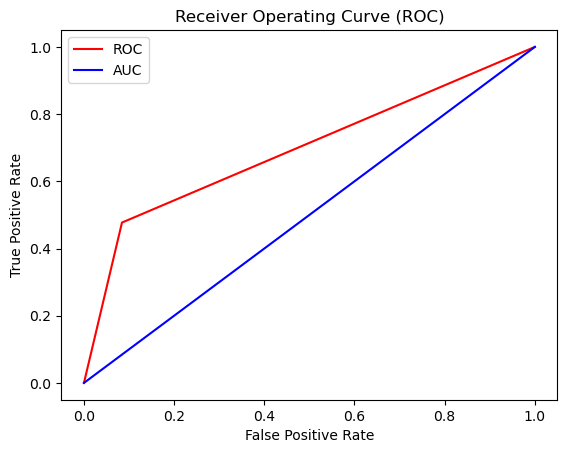

In [39]:
plt.plot(fpr, tpr, color="red", label="ROC")
plt.plot([0,1],[0,1], color="blue", label="AUC")
plt.title("Receiver Operating Curve (ROC)")
plt.legend()
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")

plt.show()

### Changing Solver

In [40]:
classifier_saga = LogisticRegression(solver="saga")

In [41]:
classifier_saga.fit(X_train, y_train)

LogisticRegression(solver='saga')

In [42]:
y_classifier_saga_prediction = classifier_saga.predict(X_test)

In [43]:
accuracy_score(y_test, y_classifier_saga_prediction)

0.7637795275590551

In [44]:
cm = confusion_matrix(y_test,y_classifier_saga_prediction)
cm

array([[76,  7],
       [23, 21]], dtype=int64)

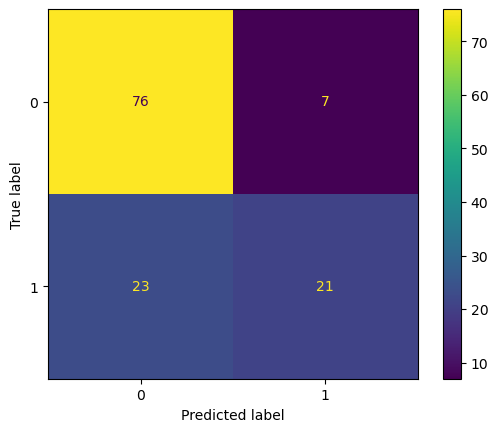

In [45]:
cmd = ConfusionMatrixDisplay(cm)
cmd.plot()

In [46]:
roc_curve(y_test,y_classifier_saga_prediction)

(array([0.        , 0.08433735, 1.        ]),
 array([0.        , 0.47727273, 1.        ]),
 array([2, 1, 0], dtype=int64))

In [47]:
roc_auc_score(y_test,y_classifier_saga_prediction)

0.6964676889375685